<a href="https://colab.research.google.com/github/rhysdg/Codes-for-Lane-Detection/blob/master/segmentation_torchvision_detectron.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<table align="right"><td>
</td><td>
  <a target="_blank"  href="https://www.weclouddata.com/">
    <img width=128px src="https://www.weclouddata.com/wp-content/uploads/2021/01/WCD-Logo.svg" /></a>
</td></table>

##Torchvision Segmntation, and Detectron 2:  Inference  and visualization Overview

Let's take a look once again at  both Torchvision and [Detectron 2](https://github.com/facebookresearch/detectron2) but through the gaze of segmentation:

- We'll take a look at two kinds of segmentation - Semantic Segmentation with [DeepLabv3](https://arxiv.org/abs/1706.05587v3) allowing us to output probability maps for n number of classes within a scene. Where we'll see that semantic segmentation may not prove our weapon of choice for the Berkeley Deep Drive context we've remained with throughout our computer vision journey, we'll therefore look to head towards an instance segmentation approach with [Mask-RCNN](https://arxiv.org/abs/1703.06870) - an extension to Faster-RCNN, allowing us to infer pixel wise classification with a mask head on top of the initial regional proposal network.

- Both of these cases once again will allow us the opportunity to flex our computer vision toolset development skills, and we'll look to build a simple visualisation module in conjunction with Torchvision, affording us a better understanding of our output masks. 

- Finally we'll revisit Detectron 2 for an easy breezy approach to inference as we explore mask-RCNN.

Alright let's get started and bring our **Yolov5_small** Berkeley Deep Drive small sample in once again as we saw during our first torchivison detection/Detectron session together:



In [ ]:
!pip install -U albumentations
!pip uninstall opencv-python-headless
!pip install opencv-python-headless==4.1.2.30

In [ ]:
!pip install --upgrade gdown
!gdown --id 1_vpBY-Gg06sSoiZpMrJ_JulnBX7elOT_
!tar xzvf bdd_yolo_small.tar.gz

In [5]:
import os
import numpy as np
import torch
import torchvision
import cv2
from PIL import Image
from matplotlib import pyplot as plt
from torchvision import transforms 

##Architecture

In [6]:
# Download a pretrained model
#del model
model = torchvision.models.segmentation.deeplabv3_resnet101(pretrained=True)


model.eval()

Downloading: "https://download.pytorch.org/models/deeplabv3_resnet101_coco-586e9e4e.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet101_coco-586e9e4e.pth


  0%|          | 0.00/233M [00:00<?, ?B/s]

DeepLabV3(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Se

- Once again as in all deep vision cases we've seen so far a feature extraction backbone begins the process of extracting features with a **(7,7)** kernel `Conv2D` with a stride of 2 followed by `MaxPool2d`, followed by several convolutional blocks.

- The real beauty of Deeplab v3's approach however is in it's use of Atrous, or dilated Convolutions `ASPPConv`, which are essentially `Conv2D` layers with large dilations. These types of convolutions essentially increase the receptive field of a kernel without increasing computational complexity by spacing the kernel weights with zeroes. While dilated convolutions can be found in a variety of segmentation networks such as [UNet](https://arxiv.org/abs/1505.04597) note that Deeplab v3 uses 4 different dilation rates,  allowing the network to capture objects at different scales, and contexts.

- Finally our fully convolutional head reduces our depth of **256** channels to 21 with a **(1,1)** kernel giving us our resultant **(n classes, height, width)** probablity maps.

In [7]:
model.aux_classifier

FCNHead(
  (0): Conv2d(1024, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU()
  (3): Dropout(p=0.1, inplace=False)
  (4): Conv2d(256, 21, kernel_size=(1, 1), stride=(1, 1))
)

##Preprocessing - Mini-challenge

This time around we'll avoid building a custom data loader and aim to preprocess a single image at a time given that our design sits close to the video inference pipeline we took a look at with our torchvision detection investigation. We can always chase batch inference as a future design initiative! For now let's do the following:

- Note that I have and example image loaded for you already as a numpy array, and subsequently converted with `cv2.COLOR_BGR2RGB`.

- Go ahead and ultilize `albumentations` to normalize your image, resize to half it's resolution for the sake of computational efficiency, and finally convert to tensor before adding a batch dimension.


In [8]:
import glob
import cv2

images = glob.glob('/content/bdd_yolo/images/val/*')
imarray = cv2.imread('/content/bdd_yolo/images/val/b57dee9d-e5bd3142.jpg')
img = cv2.cvtColor(imarray, cv2.COLOR_BGR2RGB)

In [9]:
###your code here###

###end###

#Inference

Alright! Let's add another level to our original object detection label maps this time around:

- Note that we're including a custom rgb label mapping for each of the 21 classes included in this particular family of semantic segmentation models included with torchvision, trained on a subset of the coco dataset. 

In [10]:
# Define the class names given by PyTorch’s official Docs
semantic = True#@param{type: 'boolean'}

if semantic:
 coco_classes =  {'__background__':(0, 0, 0), 
                  'aeroplane': (128, 0, 0), 
                  'bicycle': (0, 128, 0), 
                  'bird': (128, 128, 0), 
                  'boat': (0, 0, 128), 
                  'bottle': (128, 0, 128), 
                  'bus': (0, 128, 128),
                  'car': (128, 128, 128), 
                  'cat': (64, 0, 0), 
                  'chair': (192, 0, 0), 
                  'cow': (64, 128, 0), 
                  'diningtable': (192, 128, 0), 
                  'dog': (64, 0, 128), 
                  'horse': (192, 0, 128), 
                  'motorbike': (64, 128, 128),
                  'person': (192, 128, 128), 
                  'pottedplant': (0, 64, 0), 
                  'sheep': (128, 64, 0), 
                  'sofa': (0, 192, 0), 
                  'train': (128, 192, 0), 
                  'tvmonitor': (0, 64, 128)}
else:

  coco_classes = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

- From here on out we're in familiar territory and inference is a matter of moving our model to our target device, along with our input image/batch.

In [11]:
import torchvision.transforms.functional as F

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

model = model.to(device)
output = model(image.to('cuda'))['out']

print(output.shape)

torch.Size([1, 21, 360, 640])


- However, as we touched on during our architure overview - our output tensor is different to the our familiar classification vector, or our multi-dimensional score, class, coordinates output we'd find with object detection. This time around we're looking at a **(height, width)** output for each of our 21 classes, designating a map of an individual class at each pixel.

- Wrapping an normalizing our outputs with `torch.nn.functional.softmax` thus gives us a probability map for each class at each pixel.

In [12]:
prob_masks = torch.nn.functional.softmax(output, dim=1)

- Whereas wrapping our outputs with `torch.argmax` across `dim=0` gives us the the index of the pixel across all all 21 maps with the highest value. For instance a well converged model presented with a scene of cars would give us an index of 7 at that particular pixel

In [13]:
all_labels_argmax = torch.argmax(output.squeeze(), dim=0)
print(all_labels_argmax.shape)

torch.Size([360, 640])


In [23]:
all_labels_argmax[150:160, :]

tensor([[ 0,  0,  0,  ..., 15, 15, 15],
        [ 0,  0,  0,  ..., 15, 15, 15],
        [ 0,  0,  0,  ..., 15, 15, 15],
        ...,
        [ 0,  0,  0,  ..., 15, 15, 15],
        [ 0,  0,  0,  ..., 15, 15, 15],
        [ 0,  0,  0,  ..., 15, 15, 15]], device='cuda:0')

- Aha! As a result here we're now mapped to our categorical labels. - Now if we throw this all together and plot our results we get a better understanding of what our output predictions are!

- Now if we throw this all together and plot our results we get a better understanding of what our output predictions are!

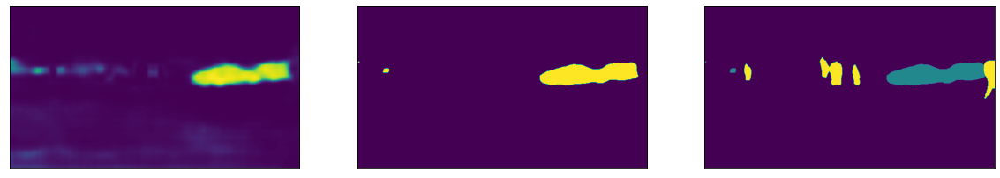

In [14]:
sem_class_to_idx = {cls: idx for (idx, cls) in enumerate(list(coco_classes.keys()))}


classname ='car' #@param{type: 'string'}

prob_masks = torch.nn.functional.softmax(output, dim=1)
class_mask = prob_masks[0, sem_class_to_idx[classname]]

boolean_mask = (output.argmax(1) == sem_class_to_idx[classname])

all_labels_argmax = torch.argmax(output.squeeze(), dim=0)
    

imgs = [class_mask, 
        boolean_mask.float(), 
        all_labels_argmax]

fix, axs = plt.subplots(ncols=len(imgs), figsize=(20,15))
for i, img in enumerate(imgs):
    img = img.detach().cpu().numpy()
    img = img.squeeze()
    axs[i].imshow(img)
    axs[i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

- Now in order to reconstruct our masks according to our custom rgb labels let's go ahead and pull off the follwing:

  - First up we're grabbing the all of our dictionary value mapping per clas with `list(coco_classes.values())`. Following which we're grabbing the index for each maximum value across all probability maps with `torch.argmax`.
  - Next up we're initialised zeroes the shape of our resulstant labels for each required channel of our resultant RGB image with `np.zeroes_like` - so a **(360, 640)** array for each channel.
  - Finally we're looping through our per-lable RGB label map, grabbing a boolean mask where our predicted `labels==current label`and assigning the appropriate red, green, and blue value to the corresponding indeces.

  - Our resultant RGB image is then the result of stacking our sperate channels across `axis=2`

In [55]:
label_map = list(coco_classes.values())
labels = torch.argmax(output.squeeze(), dim=0).detach().cpu().numpy()

red = np.zeros_like(labels).astype(np.uint8)
green = np.zeros_like(labels).astype(np.uint8)
blue = np.zeros_like(labels).astype(np.uint8)

for label_num in range(0, len(label_map)):
    index = labels == label_num
    red[index] = np.array(label_map)[label_num, 0]
    green[index] = np.array(label_map)[label_num, 1]
    blue[index] = np.array(label_map)[label_num, 2]

  
segmented_image = np.stack([red, green, blue], axis=2)


In [51]:
segmented_image.shape

(360, 640, 3)

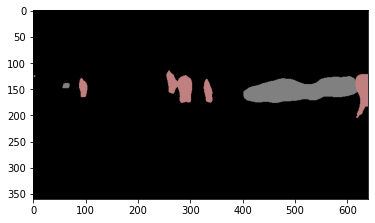

In [53]:
plt.imshow(segmented_image);

- Finally in order to appply our mask to the original image let's take care of a few things:

  - Recall that we halved the resolution of our image in order to ensure that we don't run out of video memory. Our first port of call is therefore to resize our original image to match the resolution of our mask at **(640, 360, 3)**.

  - Next up `cv2.addWeighted` allows us to to combine two images with a weighted average of the two. Where **alpha** denotes the wait of the first image, and our **beta** gives the weight of the second. Given this note that we're fixing our `beta=1` to return the original image, and keeping our alpha as variable for experimentation.

  - Finally we resize the both combined to our original target size and there you have it!

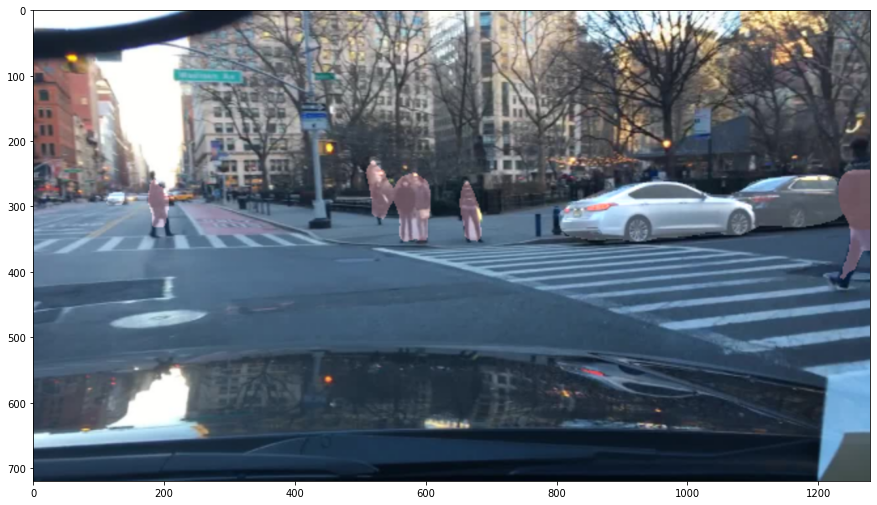

In [71]:
alpha = 0.5#@param {type:"slider", min:0, max:2, step:0.1}

ims = cv2.resize(imarray, (640,360), interpolation=cv2.INTER_AREA)
segmented_image = cv2.cvtColor(segmented_image, cv2.COLOR_RGB2BGR)
cv2.addWeighted(segmented_image, alpha, ims, 1, 0, ims)

ims = cv2.resize(ims, (1280, 720))
ims = cv2.cvtColor(ims, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15,10))
plt.imshow(ims);

##Challenge 1a

Alright! Over to you! Let's go ahead and throw all of the above together into an inference module in a similar fashion to our Torchvision detection session:

- First up note that I've left a portion of our final `viz` function once again, allowing us to  deal with either ain inciming numpy array, or read an input image filename string. Should we pass an image string out resultant mask will outputted for use. providing a numpy array will return a final array affording us the ability to write to video once again.

- Your task here is to put together a collection of functions and operations based on what we've seen so far during our session:

 - First up go ahead and put together an `inference` function that takes care of moving our model, an image to device along with transforming each individual incoming image.

 - Next up ensure that you're grabbing the `torch.argmax` for your labels along  with detaching the resultant tensor to numpy before mapping the resultant labels to our RGB label map as we've seen above.

 - Finally create your `cv2.addWeighted` weighted average and return it for use with your `viz` function.


Once you're done go ahead and run `#test1` to verify you work.



In [ ]:
###your functions here###

###end###

def viz(img, alpha=1.2, vid=False):

  if type(img) == str:
    image = cv2.imread(img) 
    image= cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
   
  else:
    image=img
    vid=True


  ###your code here###


  ####end###
  if not vid:

    plt.figure(figsize=(15,10))
    plt.imshow(final_image)

  else:
    return final_image



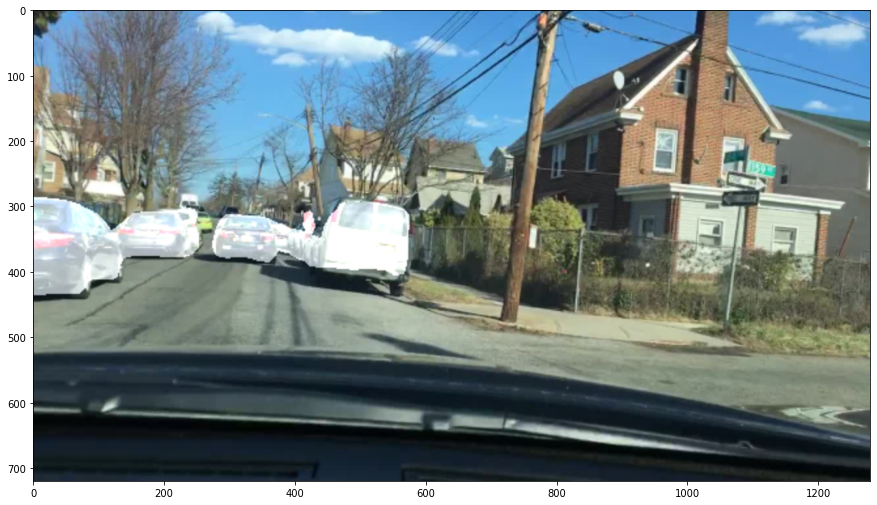

In [112]:
##test 1

num = 800


viz(images[num], alpha=1.2)

##Challenge 1b

Once again let's go ahead and fulfill our second test case, recall a few things from our last session:

- Notice that once you have your `viz` function plugged in I've provided a `try except` block once that allows us to cut the video detection at any point in time, releasing both the video capture and writer, allowing us to verify the video at any point during it's progress.

In [94]:
import cv2
from tqdm.notebook import tqdm


def video_detection(model, video, threshold = 0.8, 
                    save_name= "output.mp4",
                    width = 1920,
                    height = 1080,
                    fps=30,
                    codec='mp4v'):

  output_size = (width, height)

  out = cv2.VideoWriter(save_name,cv2.VideoWriter_fourcc(*codec), fps , output_size) 
  cap = cv2.VideoCapture(video) 
  total = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

  try:
    with tqdm(total=total) as pbar:
      while cap.isOpened():
          ret, img = cap.read()
          if not ret:
            print('done!')
            break
          
          ###your function here###

      
          ###end###


          out.write(cv2.resize(res, (width, height)))  
          pbar.update(1)
  


      cap.release()
      out.release()

  except KeyboardInterrupt:
    cap.release()
    out.release()




- Once again grab our test video with `gdown` as below and run `##test2` to complete the second video creation scenario:

In [81]:
!gdown --id 1F97YHjWTRNdVToFPT8Q60dGJwDFN0nZ_

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1F97YHjWTRNdVToFPT8Q60dGJwDFN0nZ_
To: /content/montreal-2.mp4
100% 26.4M/26.4M [00:01<00:00, 18.1MB/s]


In [108]:
##test2
video_detection(model, '/content/montreal-2.mp4')

  0%|          | 0/2141 [00:00<?, ?it/s]

done!


- Note that despite providing an `fps` rgument to our detection pipeline we'd still receive a super fast video given the lack of a `cv2.waitKey` during our frame capture loop to offset our capture given our original video's framerate. In order to shortcut this for now I've provided a post-processing snippet below allowing us to deal with a few scenarios:

  - First up within `create_video` we're locating any intermediate stage conversions and dleteing for a fresh project with our `os.remove` logic as we've seen before:

  - Next up we're utilizing `ffmpeg`'s Ptyhon wrapper to trim our video and compress with the `libx264` codec. Note that we're trimming our video despite a potentially longer output video given that Colab doesn't deal too well with outputting large HTML videos. This is very much a colab specific problem and leaving `end=0` at it's default will return the whole video for copy or download.

  - Finally we're utilizing the fantastic `MP4Box` to adjust our fps in post, again we default to `30` here but I'm adjusting to 60fps for a nice and smooth video. 

In [ ]:
deps = True #@param{type: 'boolean'}

if deps:
  !pip install ffmpeg-python
  !pip install sox
  !sudo apt-get install -y gpac

In [109]:
import base64
from IPython.display import HTML
import os
import ffmpeg
import glob2

def create_video(input = 'output.mp4', 
               fps = 30, 
               start=0,
               end=0,
               video_width = 640,
               video_height = 640):
  
  path = 'compressed.mp4'
  compressed_adjusted = f"compressed_{fps}fps.mp4"

  files = glob.glob('compressed*')
  for f in files:
    os.remove(f)

  print(f'Trimming and compressing {input}...')

  in_file = ffmpeg.input(input)
  if end > 0:
    in_file = in_file.trim(start=start, end=end)
  out = ffmpeg.output(in_file, path, vcodec='libx264', crf=28)
  ffmpeg.run(out)

  print(f'Adjusting to {fps} fps...')

  os.system(f'MP4Box -add {path} -raw 1 -new test')
  os.system(f'MP4Box -add test_track1.h264:fps={fps} -new {compressed_adjusted}')

  print('Done!')

  return compressed_adjusted


In [110]:
out = create_video(input='output.mp4', fps=60, end=30)

Trimming and compressing output.mp4...
Adjusting to 60 fps...
Done!


In [111]:
import base64
from IPython.display import HTML

video_width = 640
video_height = 640

video = open(out, "r+b").read()
video_url = f"data:video/mp4;base64,{base64.b64encode(video).decode()}"
HTML(f"""<video height={video_height} width={video_width} controls><source src="{video_url}"></video>""")

There we have it once again! Now it's worth noting a few things here before we take a look at an alternative approach:

- Note first up that while we're sticking with our traffic context for ease of use and a consistent analysis of all our computer vision architecture semantic segmentation isn't necessarily the most effective approach here. We have ourselves a fairly busy scene, with clusters of class based pixels struggling to mold to an ever changing problem. Athough despite the lack of pixel perfect classification we're localising the general whereabouts of a class pretty effectively.

- Further solutions aren't held within the torchvision ecosystem but within the Detectron 2 framework as a variety of experimental projects such as [Point Rend](https://github.com/facebookresearch/detectron2/tree/main/projects/PointRend), and Deeplab's successor - Deeplabv3+ -  trained on the Cityscapes [Cityscapes](https://www.cityscapes-dataset.com/) dataset

- It's worth noting ultimately that semantic segmentation is better suited variety of other problem domains - for example a medical context where we may wish to train a segmentation model to annex abnormalities etc.

In order to solve a busy, shifting traffic scene from the gaze of an ego vehicle let's look at instance segmentation, where we're able to marry a pixel level approach with the benefits of instance based localisation we saw with object detection.

##Detectron 2

Let's take a look at what [Detectron 2](https://github.com/facebookresearch/detectron2) can do for us, affording us an easy high-level API, but before we take a brief overview of our model of choice - **mask-rcnn** - let's get our dependencies installed:

- Note frst up that we're going to need to upgrade `torchvision` and install `fvcore`, a set of core dependencies for torch based vision.

- Last of all we'll need to clone `detectron2` and do a quick `pip install` before resetting our colab runtime with `Runtime - Restart runtime` 

In [ ]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
import torch, torchvision
torch.__version__

In [ ]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

From here on out things are super simple:

- First up we're import our predictior, out of the box visualtion tools and even a config parser `get_cfg()` that allows us to take care of grabbing the pretrained weights we need by simply providing the model's config `.yaml`

In [58]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

from detectron2.projects import point_rend
from detectron2.projects import deeplab

- Next up we're returning a particular model's config based on our dropdown choice, feel free to add models to the cell and note that you can take a walk through the model zoo at the link provided. The choice of dictionary here affords us further room for adding concepts such as custom weights to a `model_dict[choice]['weights']` key shoudl we need given that bleeding edge models don't always provide wigths compatible with the config parser.

In [141]:
#more models at: https://github.com/facebookresearch/detectron2/blob/main/MODEL_ZOO.md

choice = 'mask_rcnn_R_50_FPN_3x'#@param ['mask_rcnn_R_50_FPN_3x','faster_rcnn_R_50_FPN_3x', 'pointrend_rcnn_R_50_FPN_3x_coco', 'pointrend_semantic_R_101_FPN_1x_cityscapes']

model_dict = {'mask_rcnn_R_50_FPN_3x':{'config':'COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'},
              'pointrend_rcnn_R_50_FPN_3x_coco': {'config': "detectron2_repo/projects/PointRend/configs/InstanceSegmentation/pointrend_rcnn_R_50_FPN_3x_coco.yaml", 
                            'weights':  "detectron2://PointRend/InstanceSegmentation/pointrend_rcnn_R_50_FPN_3x_coco/164955410/model_final_edd263.pkl"},
              'faster_rcnn_R_50_FPN_3x':{'config':'detectron2_repo/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml'},
              }

config = model_dict[choice]['config']

In [128]:
print(config)

COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml


- From here on out we're in familiar territory and grabbing a single image for a forward pass. Note that the high-level API doesn't currently support batch inference, but calling a model within the Detectron 2 framework allows for this functionality.

In [129]:
import glob
images = glob.glob('/content/bdd_yolo/images/val/*')

In [130]:
img = cv2.imread(images[0])

- After which it's a matter of just passing our config to our `DefaultPredictor` class, and grabbing our checkpint via `model_zoo.get_checkpoint_url`, whilst also providing an appropriate `threshold` to tune out any false positives.

In [131]:
model_dict[choice]

{'config': 'COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'}

In [133]:
threshold = 0.8 #@param {type:"slider", min:0, max:1, step:0.1}


cfg = get_cfg()

if 'PointRend' in config:
  point_rend.add_pointrend_config(cfg)


cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = threshold
if model_dict[choice].get('weights') == None:
  cfg.merge_from_file(model_zoo.get_config_file(config))
  cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(config)
else:
  cfg.merge_from_file(config)
  cfg.MODEL.WEIGHTS = model_dict[choice]['weights']

predictor = DefaultPredictor(cfg)
outputs = predictor(img)

[05/14 22:52:41 fvcore.common.checkpoint]: [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


model_final_f10217.pkl: 178MB [00:08, 20.6MB/s]                           


[05/14 22:52:50 fvcore.common.checkpoint]: Reading a file from 'Detectron2 Model Zoo'


In [134]:
!ls detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml

detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml


##Architecture

With regards to the  architecture itself we're building off of the intuition of faster-rcnn here:

- Our backbone does our initial feature extraction before passing the resultant feature maps to a Regional Proposal Network, where regions of interest are decided relative to our predefined anchor boxes before being passed to our fully connected head for bounding box regression relative to these regions, along with object classification (80 coco classes + 1 background)


In [135]:
predictor.model.roi_heads.box_predictor

FastRCNNOutputLayers(
  (cls_score): Linear(in_features=1024, out_features=81, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=320, bias=True)
)

- The difference here however is that we have a mask head consisting of a collection of fully convolutional layers followed by `ConvTranspose2D` in order to upsample our image and give us a resultant prediction mask per region of interest.

In [136]:
predictor.model.roi_heads.mask_head

MaskRCNNConvUpsampleHead(
  (mask_fcn1): Conv2d(
    256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)
    (activation): ReLU()
  )
  (mask_fcn2): Conv2d(
    256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)
    (activation): ReLU()
  )
  (mask_fcn3): Conv2d(
    256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)
    (activation): ReLU()
  )
  (mask_fcn4): Conv2d(
    256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)
    (activation): ReLU()
  )
  (deconv): ConvTranspose2d(256, 256, kernel_size=(2, 2), stride=(2, 2))
  (deconv_relu): ReLU()
  (predictor): Conv2d(256, 80, kernel_size=(1, 1), stride=(1, 1))
)

##Inference



-  Our output bounding box detections then are pretty familiar to us by this point - A **(n detections, coordinates)** tensor and a **n detections** length score and class tensor, just like our faster-rcnn session together.

In [137]:
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)
print(outputs["instances"].scores)

tensor([2, 2, 2, 2, 2, 2, 2, 2, 2], device='cuda:0')
Boxes(tensor([[ 394.5233,  314.8479,  462.7566,  368.6208],
        [ 594.5907,  327.2039,  621.3311,  355.5490],
        [ 927.5626,  342.2401, 1278.1143,  655.4442],
        [   0.0000,  277.9846,  245.6129,  518.9473],
        [ 148.5954,  283.5497,  364.4119,  423.3912],
        [ 486.8509,  326.1700,  510.5090,  348.4235],
        [ 760.2087,  336.8766, 1096.1050,  506.9352],
        [ 456.7074,  321.7405,  488.8879,  353.9782],
        [ 505.9431,  324.4839,  526.4711,  342.8483]], device='cuda:0'))
tensor([0.9925, 0.9852, 0.9843, 0.9793, 0.9696, 0.9668, 0.9607, 0.9360, 0.8209],
       device='cuda:0')


- In this particular case however we get boolean masks that are **(n instances, image height, image_width)** - the may then be used should we wish build our own set of tools that are more specific to our needs. 

In [138]:
print(f'{outputs["instances"].pred_masks.shape}\n')

print(f'{outputs["instances"].pred_masks[0].shape}\n')
print(outputs["instances"].pred_masks[0])


torch.Size([9, 720, 1280])

torch.Size([720, 1280])

tensor([[False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        ...,
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False]], device='cuda:0')



- Recall once again however that we don't need to build a visualization tool from the ground up to verify our model out of the box as we're able to take care of this with the `Visualizer` class and it's `draw_instance_predictions` method.

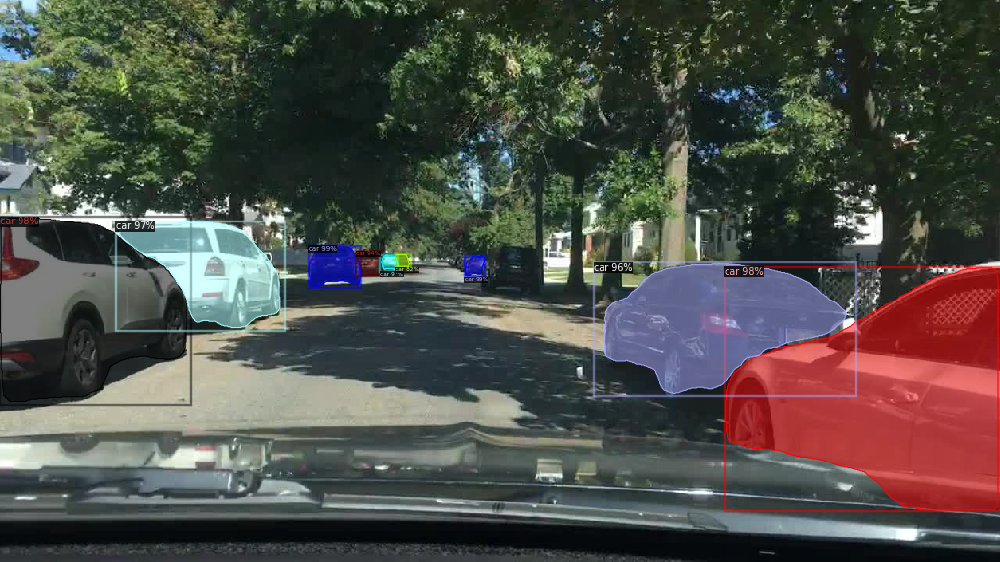

In [139]:
scale = 0.8 #@param {type:"slider", min:0, max:1, step:0.1}

v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=scale)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

##Video API

Finally, should we wish we may combine above with our newly acquired video creation skills but let's look at a simple shortcut that allows us to verify a model with a video on the fly with ease:

- Simply run the cell below to dial in your weights from our earlier foray into Detectron 2 - notice that I'm dropping `https://dl.fbaipublicfiles.com/detectron2/` in order to append the `.yaml` file name to `detectron2://`

- The rest of the command line interface here is pretty straightforward where we're passint our `--video-input`, your chosen `--confidence-threshold` and your required `--output` filename.

In [140]:
config

'COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'

In [ ]:
import os
import re
output_name = 'video-output.mp4'

if os.path.isfile(output_name):
  os.remove(output_name)

weights = re.sub('https://dl.fbaipublicfiles.com/detectron2/',"", cfg.MODEL.WEIGHTS)

%run detectron2/demo/demo.py --config-file {config} --video-input '/content/montreal-2.mp4' --confidence-threshold 0.6 --output {output_name} \
  --opts MODEL.WEIGHTS detectron2://{weights}

- Finally once again let's run our resultant video through custom postprocessing function in order to view it within the colab notebook, although once again you may set `end=0` to compress the video ready for export to another environment.

In [ ]:
out = create_video(input='video-output.mp4', fps=60, end=20)

Trimming and compressing video-output.mp4...
Adjusting to 60 fps...
Done!


In [ ]:
video_width = 640
video_height = 640

video = open(out, "r+b").read()
video_url = f"data:video/mp4;base64,{base64.b64encode(video).decode()}"
HTML(f"""<video height={video_height} width={video_width} controls><source src="{video_url}"></video>""")


Aha! Taking the instance based approach here in conjunction with the pixel-level inference of mask-RCNN's mask head is a vast improvement on our first pass with semantic segmentation!